In [1]:

library(Seurat)
library(ggplot2)
library(dplyr)

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following objects are masked from ‘package:base’:

    intersect, t



Attaching package: ‘dplyr’


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union




# fix data incompatability

In [2]:
working_dir <- "/scratch/user/uqyche42/projects/HNC/"
sample_ids <- c("VLP39_A2", "VLP39_B2", "VLP39_C2", "VLP39_D2")

In [3]:
# load data
VLP39_A2 <- Load10X_Spatial(data.dir = "/QRISdata/Q4793/deconvolution/head_neck_cancer_VLP39_A2_outs",filename = "filtered_feature_bc_matrix.h5")
VLP39_B2 <- Load10X_Spatial(data.dir = "/QRISdata/Q4793/deconvolution/head_neck_cancer_VLP39_B2_outs",filename = "filtered_feature_bc_matrix.h5")
VLP39_C2 <- Load10X_Spatial(data.dir = "/QRISdata/Q4793/deconvolution/head_neck_cancer_VLP39_C2_outs",filename = "filtered_feature_bc_matrix.h5")
VLP39_D2 <- Load10X_Spatial(data.dir = "/QRISdata/Q4793/deconvolution/head_neck_cancer_VLP39_D2_outs",filename = "filtered_feature_bc_matrix.h5")

In [4]:
sample_list <- list()
for (sample_id in sample_ids) {
  sample_list[[sample_id]] <- get(sample_id)
}

In [5]:
sample_list[["VLP39_A2"]]@meta.data$slide<-"A"
sample_list[["VLP39_B2"]]@meta.data$slide<-"B"
sample_list[["VLP39_C2"]]@meta.data$slide<-"C"
sample_list[["VLP39_D2"]]@meta.data$slide<-"D"  

for (sample in names(sample_list)) {
    sample_list[[sample]]@meta.data$individual <- paste0(sample_list[[sample]]@meta.data$slide,"_", rownames(sample_list[[sample]]@meta.data)) 
}

In [6]:
merged_VLP39 <- merge(sample_list[["VLP39_A2"]], y = c(sample_list[["VLP39_B2"]], sample_list[["VLP39_C2"]], sample_list[["VLP39_D2"]]), add.cell.ids = c("A", "B", "C", "D"), project = "VLP39")

Warning message:
“Key ‘slice1_’ taken, using ‘slice12_’ instead”
Warning message:
“Key ‘slice1_’ taken, using ‘slice13_’ instead”
Warning message:
“Key ‘slice1_’ taken, using ‘slice14_’ instead”


In [25]:
options(future.globals.maxSize = 5e+10)
merged_VLP39 <- SCTransform(merged_VLP39,assay = "Spatial")
merged_VLP39 <- RunPCA(merged_VLP39, npcs = 30, verbose = F)
merged_VLP39 <- IntegrateLayers(
  object = merged_VLP39,
  method = RPCAIntegration,
  normalization.method = "SCT",
  verbose = F
)

Running SCTransform on assay: Spatial



vst.flavor='v2' set. Using model with fixed slope and excluding poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 16045 by 3652

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 3652 cells

Found 68 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 16045 genes

Computing corrected count matrix for 16045 genes

Calculating gene attributes

Wall clock passed: Time difference of 23.08941 secs

Determine variable features

Centering data matrix

Place corrected count matrix in counts slot

vst.flavor='v2' set. Using model with fixed slope and excluding poisson genes.

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 16010 by 3521

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene



In [43]:
dim(merged_VLP39@meta.data)

[1] 14819     7

In [7]:
seurat_object <- readRDS("/QRISdata/Q4793/seurat_objects/data.filt_sct.RDS")

In [9]:
colnames(seurat_object@meta.data)

[1] "orig.ident"       "nCount_Spatial"   "nFeature_Spatial" "cell_type"       
 [5] "recurrent"        "tissues"          "sample_id"        "p16_status"      
 [9] "tissue_site"      "slide"            "nCount_SCT"       "nFeature_SCT"

In [32]:
# Get common cell IDs
common_cells <- intersect(Cells(merged_VLP39), Cells(seurat_object))

# Subset merged_VLP39 to only those cells
merged_VLP39_filtered <- subset(merged_VLP39, cells = common_cells)

Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV o

In [33]:
# Extract desired metadata from seurat_object
metadata_to_transfer <- seurat_object@meta.data[common_cells, 
    c("cell_type", "recurrent", "tissues", 
      "sample_id", "p16_status", "tissue_site")]

# Add/overwrite these columns in merged_VLP39_filtered
merged_VLP39_filtered@meta.data[common_cells, colnames(metadata_to_transfer)] <- metadata_to_transfer

In [44]:
# save
saveRDS(merged_VLP39_filtered, file = "merged_VLP39_filtered.rds")

In [139]:
table(merged_VLP39_filtered@meta.data$p16_status,merged_VLP39_filtered@meta.data$sample_id)

          
           P18262_no_event P18588_event P25115_no_event P28310_event
  negative               0         1765               0            0
  positive             931            0             880         1508
  unknown                0            0               0            0
          
           P28724_no_event P35384_no_event P52393_no_event P603922_event
  negative               0               0               0          1581
  positive               0               0             964             0
  unknown             1716            1637               0             0
          
           P9237_event P9900_no_event
  negative        1505           1125
  positive           0              0
  unknown            0              0

In [145]:
merged_VLP39_filtered@meta.data[merged_VLP39_filtered@meta.data$sample_id=="P28310_event",]

,orig.ident,nCount_Spatial,nFeature_Spatial,slide,individual,nCount_SCT,nFeature_SCT,cell_type,recurrent,tissues,sample_id,p16_status,tissue_site
,<chr>,<dbl>,<int>,<chr>,<chr>,<dbl>,<int>,<chr>,<chr>,<chr>,<chr>,<chr>,<chr>
C_AAACAACGAATAGTTC-1,SeuratProject,26156,7522,C,C_AAACAACGAATAGTTC-1,2947,2199,tumour,recurrent,C1,P28310_event,positive,oropharynx
C_AAACAATCTACTAGCA-1,SeuratProject,8283,4255,C,C_AAACAATCTACTAGCA-1,2251,1620,stroma,recurrent,C1,P28310_event,positive,oropharynx
C_AAACAGAGCGACTCCT-1,SeuratProject,2574,1133,C,C_AAACAGAGCGACTCCT-1,2444,1084,tumour,recurrent,C2,P28310_event,positive,oropharynx
C_AAACCACTACACAGAT-1,SeuratProject,44941,9174,C,C_AAACCACTACACAGAT-1,2591,1878,tumour,recurrent,C2,P28310_event,positive,oropharynx
C_AAACGACAGTCTTGCC-1,SeuratProject,21608,6666,C,C_AAACGACAGTCTTGCC-1,2690,1765,tumour,recurrent,C2,P28310_event,positive,oropharynx
C_AAACGCCCGAGATCGG-1,SeuratProject,17678,6226,C,C_AAACGCCCGAGATCGG-1,2710,1850,tumour,recurrent,C2,P28310_event,positive,oropharynx
C_AAACGGGTTGGTATCC-1,SeuratProject,6739,3745,C,C_AAACGGGTTGGTATCC-1,2887,2186,tumour,recurrent,C1,P28310_event,positive,oropharynx
C_AAACGTGTTCGCCCTA-1,SeuratProject,21521,6699,C,C_AAACGTGTTCGCCCTA-1,2775,1927,tumour,recurrent,C2,P28310_event,positive,oropharynx
C_AAACTAACGTGGCGAC-1,SeuratProject,7373,3513,C,C_AAACTAACGTGGCGAC-1,2502,1517,tumour,recurrent,C2,P28310_event,positive,oropharynx


# load saved data

In [3]:
# load RDS file
merged_VLP39_filtered <- readRDS("merged_VLP39_filtered.rds")

In [59]:
merged_VLP39_filtered

An object of class Seurat 
35115 features across 13612 samples within 2 assays 
Active assay: SCT (17172 features, 3000 variable features)
 3 layers present: counts, data, scale.data
 1 other assay present: Spatial
 2 dimensional reductions calculated: pca, integrated.dr
 4 spatial fields of view present: slice1 slice1.2 slice1.3 slice1.4

In [10]:
seurat_list <- SplitObject(merged_VLP39_filtered, split.by = "slide")

Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating Seurat objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating Centroids objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV objects”
Warning message:
“Not validating FOV obje

In [11]:
# Assuming your list of Seurat objects is called 'seurat_list'

# Using lapply to modify all objects in the list
seurat_list <- lapply(seurat_list, function(seurat_obj) {
  # Get current cell names
  old_names <- Cells(seurat_obj)
  
  # Remove prefix (everything before and including underscore) and replace hyphen with dot
  new_names <- gsub("^[A-Z]_", "", old_names)  # Remove prefix
  new_names <- gsub("-", ".", new_names)       # Replace hyphen with dot
  
  # Rename cells
  seurat_obj <- RenameCells(seurat_obj, new.names = new_names)
  
  return(seurat_obj)
})

In [4]:
rotate_slide_coords <- function(seu) {
  # Get the coordinates
  coords <- GetTissueCoordinates(seu)
  
  # Flip x coordinates
  coords$x <- max(coords$x) - coords$x + min(coords$x)
  
  # Rotate 90 degrees: swap x and y
  temp <- coords$y
  coords$y <- coords$x
  coords$x <- temp
  
  # Return the modified coordinates
  return(coords)
}

In [5]:
add_gene_to_card <- function(seurat_obj, card_table, gene_name, slot = "data") {
  # Check if gene exists in Seurat object
  if (!gene_name %in% rownames(seurat_obj)) {
    stop(paste("Gene", gene_name, "not found in Seurat object"))
  }
  
  # Extract gene expression from Seurat object
  gene_expression <- GetAssayData(seurat_obj, slot = slot)[gene_name, ]

    # Impute values <= 0 with 0.00000001
  gene_expression[gene_expression <= 0] <- 0.00000001
  
  # Get column names from CARD table (all are cell barcodes)
  card_cells <- colnames(card_table)
  
  # Check for missing cells and create expression vector
  gene_values <- sapply(card_cells, function(cell) {
    if(cell %in% names(gene_expression)) {
      return(gene_expression[cell])
    } else {
      warning(paste("Cell", cell, "not found in Seurat object, setting to 0.00000001"))
      return(0.00000001)  # or NA if preferred
    }
  })
  
  # Add gene as a new row to CARD table
  updated_card <- rbind(card_table, gene_values)
  
  # Set the row name for the new row
  rownames(updated_card)[nrow(updated_card)] <- gene_name
  
  return(updated_card)
}


In [14]:
#library(CARD)
library(reshape2)
options(repr.plot.width = 15, repr.plot.height = 10)

In [6]:
visualize.prop.2CT <- function(proportion, spatial_location, ct2.visualize = ct2.visualize, colors = NULL){
  if(is.null(colors)){
    colors = list(c("lightblue","lightyellow","red"),
                  c("lightblue","lightyellow","black"))
  }else{
    colors = colors
  }
  
  res_CARD = as.data.frame(proportion)
  res_CARD = res_CARD[,order(colnames(res_CARD))]
  location = as.data.frame(spatial_location)
  
  if(sum(rownames(res_CARD)==rownames(location))!= nrow(res_CARD)){
    stop("The rownames of proportion data does not match with the rownames of spatial location data")
  }
  
  ct.select = ct2.visualize
  res_CARD = res_CARD[,ct.select]
  
  # Use original values without scaling
  res_CARD_scale = res_CARD
  res_CARD_scale$x = as.numeric(location$x)
  res_CARD_scale$y = as.numeric(location$y)
  
  mData = melt(res_CARD_scale, id.vars = c("x","y"))
  colnames(mData)[3] <- "Cell_Type"
  
  p = suppressMessages(ggplot() + 
    geom_point(data=mData[mData$Cell_Type == ct2.visualize[1],], 
               aes(x=x, y=y, color=value), shape=21, size=5) +
    scale_color_gradientn(colours = colors[[1]], limits = c(0, 1)) +  # Force legend to 0-1
    geom_point(data=mData[mData$Cell_Type == ct2.visualize[2],], 
               aes(x=x, y=y, fill = value), color = "white", shape=22, size=2) +
    scale_fill_gradientn(colours = colors[[2]], limits = c(0, 1)) +   # Force legend to 0-1
    scale_x_discrete(expand = c(0, 1)) + 
    scale_y_discrete(expand = c(0,1)) + 
    coord_fixed() +
    theme(plot.margin = margin(0.1, 0.1, 0.1, 0.1, "cm"),
          panel.background = element_blank(),
          plot.background = element_blank(),
          panel.border = element_rect(colour = "grey89", fill=NA, size=0.5),
          axis.text = element_blank(),
          axis.ticks = element_blank(),
          axis.title = element_blank(),
          legend.title = element_text(size = 14, face="bold"),
          legend.text = element_text(size = 11),
          strip.text = element_text(size = 12, face="bold"),
          legend.key.size = unit(0.45, 'cm')) +
    labs(colour = ct2.visualize[1], fill = ct2.visualize[2]))
  
  return(p)
}

In [79]:
CARD_C["PAEP",] 

,AAACAACGAATAGTTC.1,AAACAATCTACTAGCA.1,AAACACCAATAACTGC.1,AAACAGAGCGACTCCT.1,AAACAGCTTTCAGAAG.1,AAACAGGGTCTATATT.1,AAACAGTGTTCCTGGG.1,AAACATTTCCCGGATT.1,AAACCACTACACAGAT.1,AAACCGGGTAGGTACC.1,⋯,TTGTGGTGGTACTAAG.1,TTGTGTATGCCACCAA.1,TTGTGTTTCCCGAAAG.1,TTGTTAGCAAATTCGA.1,TTGTTCAGTGTGCTAC.1,TTGTTCTAGATACGCT.1,TTGTTTCACATCCAGG.1,TTGTTTCCATACAACT.1,TTGTTTGTATTACACG.1,TTGTTTGTGTAAATTC.1
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,⋯,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>
PAEP,0,0,0,0,0,0,0,0,0,0,⋯,0,0,0,0,0,0,0,0,0,0


In [85]:
GetAssayData(seurat_list[["C"]], slot = 'scale.data')["PAEP", ]

AAACAACGAATAGTTC.1 AAACAATCTACTAGCA.1 AAACACCAATAACTGC.1 AAACAGAGCGACTCCT.1 
     -1.682894e-02      -5.328880e-03      -9.263057e-05      -1.655527e-03 
AAACAGCTTTCAGAAG.1 AAACAGGGTCTATATT.1 AAACAGTGTTCCTGGG.1 AAACATTTCCCGGATT.1 
     -8.177785e-04      -1.943141e-03      -7.913978e-04      -4.407273e-04 
AAACCACTACACAGAT.1 AAACCGGGTAGGTACC.1 AAACCGTTCGTCCAGG.1 AAACCTAAGCAGCCGG.1 
     -2.891581e-02      -2.959551e-04      -4.259284e-04      -3.937568e-04 
AAACCTCATGAAGTTG.1 AAACGACAGTCTTGCC.1 AAACGAGACGGTTGAT.1 AAACGCCCGAGATCGG.1 
     -1.198047e-03      -1.390261e-02      -2.084483e-04      -1.137392e-02 
AAACGGGCGTACGGGT.1 AAACGGGTTGGTATCC.1 AAACGGTTGCGAACTG.1 AAACGTGTTCGCCCTA.1 
     -4.143466e-04      -4.335421e-03      -9.580467e-04      -1.384663e-02 
AAACTAACGTGGCGAC.1 AAACTCGGTTCGCAAT.1 AAACTGCTGGCTCCAA.1 AAACTTAATTGCACGC.1 
     -4.743357e-03      -1.645875e-03      -1.048127e-03      -1.975100e-04 
AAACTTGCAAACGTAT.1 AAAGAATGTGGACTAA.1 AAAGACATGAAGTTTA.1 AAAGACCCAAGTCGCG.1 
     -1.065500e-03      -1.741103e-03      -3.014605e-02      -2.388610e-02 
AAAGGCCCTATAATAC.1 AAAGGCTCTCGCGCCG.1 AAAGGGATGTAGCAAG.1 AAAGGGCAGCTTGAAT.1 
     -1.170810e-04      -9.777803e-05      -5.512902e-03      -2.645082e-02 
AAAGGTAAGCTGTACC.1 AAAGGTCAACGACATG.1 AAAGTAGCATTGCTCA.1 AAAGTCACTGATGTAA.1 
     -1.839827e-02      -1.237317e-02      -8.016927e-04      -2.426637e-02 
AAAGTCGACCCTCAGT.1 AAAGTGCCATCAATTA.1 AAAGTGTGATTTATCT.1 AAATAACCATACGGGA.1 
     -1.082229e-03      -3.030328e-04      -5.031402e-04      -5.703358e-03 
AAATACCTATAAGCAT.1 AAATCACTCCTAAACG.1 AAATCGTGTACCACAA.1 AAATGATTCGATCAGC.1 
     -9.316659e-04      -3.977673e-03      -2.328988e-04      -2.322079e-02 
AAATGCTCGTTACGTT.1 AAATGGCATGTCTTGT.1 AAATGGCCCGTGCCCT.1 AAATGTGGGTGCTCCT.1 
     -2.679763e-02      -2.313779e-02      -1.826680e-03      -5.427326e-03 
AAATTAATAAGCGCGA.1 AAATTACACGACTCTG.1 AAATTGATAGTCCTTT.1 AAATTGCGGCGGTTCT.1 
     -1.437404e-03      -1.544857e-03      -6.903789e-04      -1.271805e-02 
AAATTGGTGAGAAGCA.1 AAATTTACCGAAATCC.1 AAATTTGCGGGTGTGG.1 AACACGACTGTACTGA.1 
     -4.699604e-03      -3.186852e-02      -2.554189e-04      -3.350541e-02 
AACACGAGACGCGGCC.1 AACACGCGGCCGCGAA.1 AACAGGAAATCGAATA.1 AACATAGCGTGTATCG.1 
     -8.454461e-04      -8.795049e-03      -2.364675e-02      -7.782930e-03 
AACATCGATACGTCTA.1 AACATTGAAGTTGATC.1 AACATTGGTCAGCCGT.1 AACATTGTGACTCGAG.1 
     -1.573768e-02      -3.371347e-04      -1.510712e-02      -1.016386e-04 
AACCAAGACTTCTCTG.1 AACCAGTATCACTCTT.1 AACCATAGGGTTGAAC.1 AACCATGGGATCGCTA.1 
     -1.158154e-03      -1.602465e-02      -1.498960e-04      -3.107646e-02 
AACCCAGAGACGGAGA.1 AACCCGACAACCCGTG.1 AACCCGAGCAGAATCG.1 AACCCGATAGGGCTTC.1 
     -1.615462e-02      -1.376708e-04      -2.461747e-03      -4.366950e-03 
AACCCTACTGTCAATA.1 AACCCTGGTGGAACCA.1 AACCGAGCTTGGTCAT.1 AACCGCTAAGGGATGC.1 
     -4.458748e-04      -2.240621e-02      -1.799677e-02      -2.811562e-04 
AACCGTTGTGTTTGCT.1 AACCTAAAGCCGTCCG.1 AACCTTTAAATACGGT.1 AACCTTTACGACGTCT.1 
     -2.578745e-02      -2.316031e-02      -3.123839e-03      -1.832471e-03 
AACGAAAGTCGTCCCA.1 AACGACCTCCTAGCCG.1 AACGATAGAAGGGCCG.1 AACGATATGTCAACTG.1 
     -4.490919e-04      -5.475370e-04      -2.196996e-02      -9.193977e-03 
AACGCATGATCTGGGT.1 AACGCGAACGGCAACA.1 AACGCGACCTTGGGCG.1 AACGCGGTCTCCAGCC.1 
     -9.315585e-03      -2.312364e-02      -3.068934e-04      -1.055033e-02 
AACGGACGTACGTATA.1 AACGGCCATCTCCGGT.1 AACGTACTGTGGGTAC.1 AACGTAGTCTACCCAT.1 
     -7.630868e-04      -3.088237e-04      -2.180998e-04      -5.288344e-03 
AACGTCAGACTAGTGG.1 AACGTCGCTGCACTTC.1 AACGTGATGAAGGACA.1 AACGTGCGAAAGTCTC.1 
     -3.468289e-02      -3.898962e-04      -1.202057e-02      -1.318799e-04 
AACGTTATCAGCACCT.1 AACTAGCGTATCGCAC.1 AACTAGGCTTGGGTGT.1 AACTCAAGTTAATTGC.1 
     -2.604289e-02      -7.353118e-03      -8.169223e-05      -4.220678e-04 
AACTCCAGAGCGTGTT.1 AACTCCTAATCCCATG.1 AACTCGATAAACACGT.1 AACTCGATGGCGCAGT.1 
     -3.757407e-04      -2.618745e-03      -1.552342e-02      -2.373232e-

In [12]:
# load CARD_celltype
CARD_C<-read.delim("CARD_C_celltype_newref_prop.csv", sep=",", header=TRUE, row.names=1)

CARD_C <- add_gene_to_card(seurat_list[["C"]], CARD_C, "PAEP")

p3 = visualize.prop.2CT(
proportion = t(CARD_C),                             ### Cell type proportion estimated by CARD
spatial_location = rotate_slide_coords(seurat_list[["C"]]),                      ### spatial location information
ct2.visualize = c("T.cells","PAEP"),              ### two cell types you want to visualize
colors = list(c("lightblue","lightyellow","red"),c("lightblue","lightyellow","black")))       ### two color scales                             
print(p3)

Warning message:
“The `slot` argument of `GetAssayData()` is deprecated as of SeuratObject 5.0.0.
ℹ Please use the `layer` argument instead.”


ERROR: Error in melt(res_CARD_scale, id.vars = c("x", "y")): could not find function "melt"


In [108]:
row.names(CARD_C)

[1] "T.cells"           "Malignant.cells"   "B_Plasma.cells"   
 [4] "Endothelial.cells" "Fibroblasts"       "Macrophages"      
 [7] "Dendritic.cells"   "Mast.cells"        "Myocytes"         
[10] "Epithelial.cells"  "PAEP"

# plot T cell B cell co-localisation

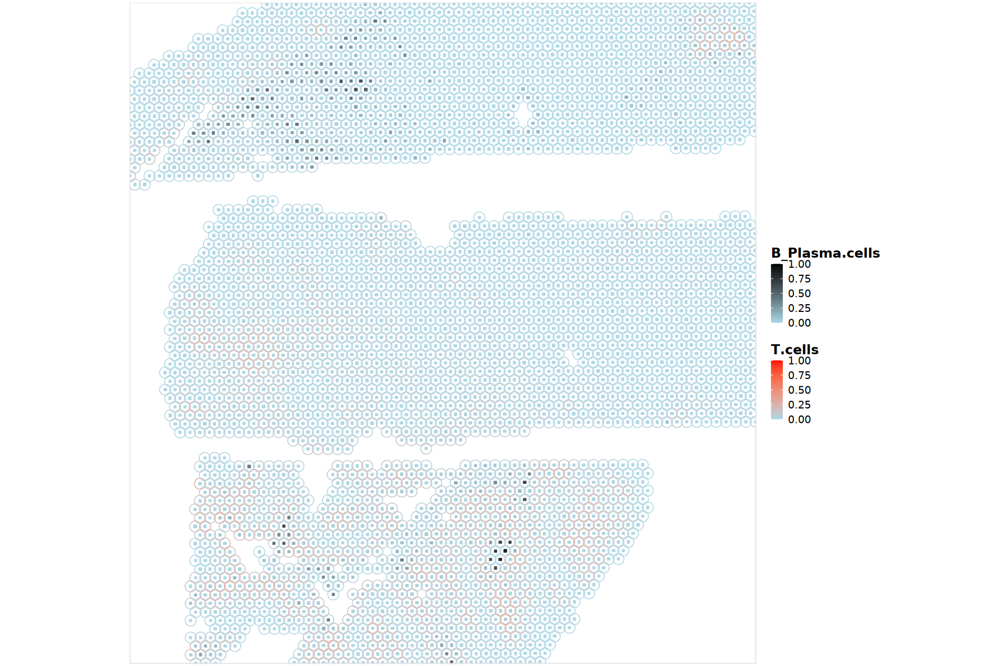

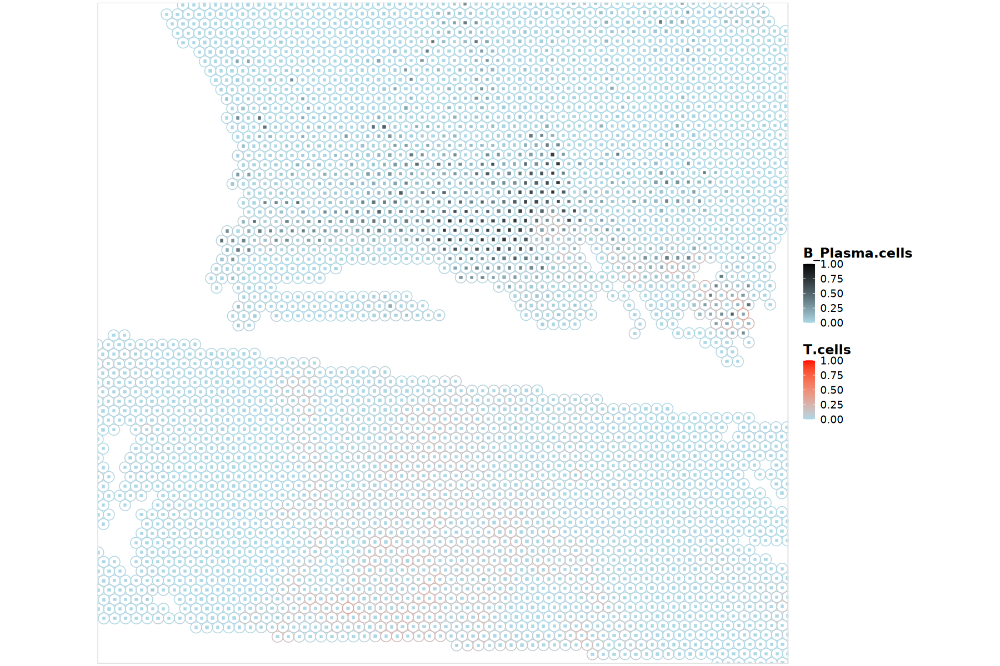

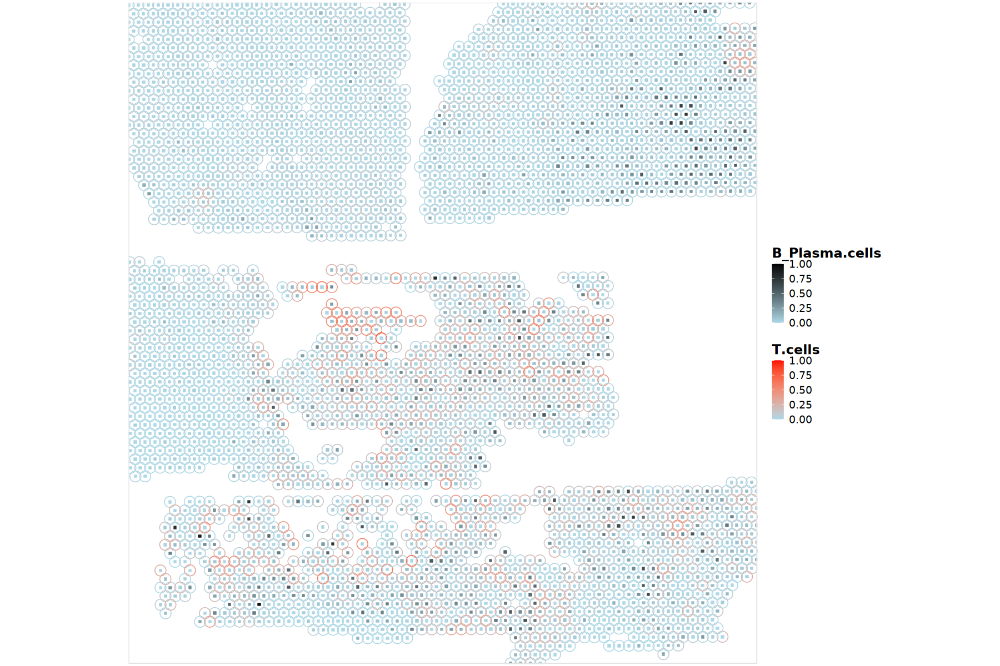

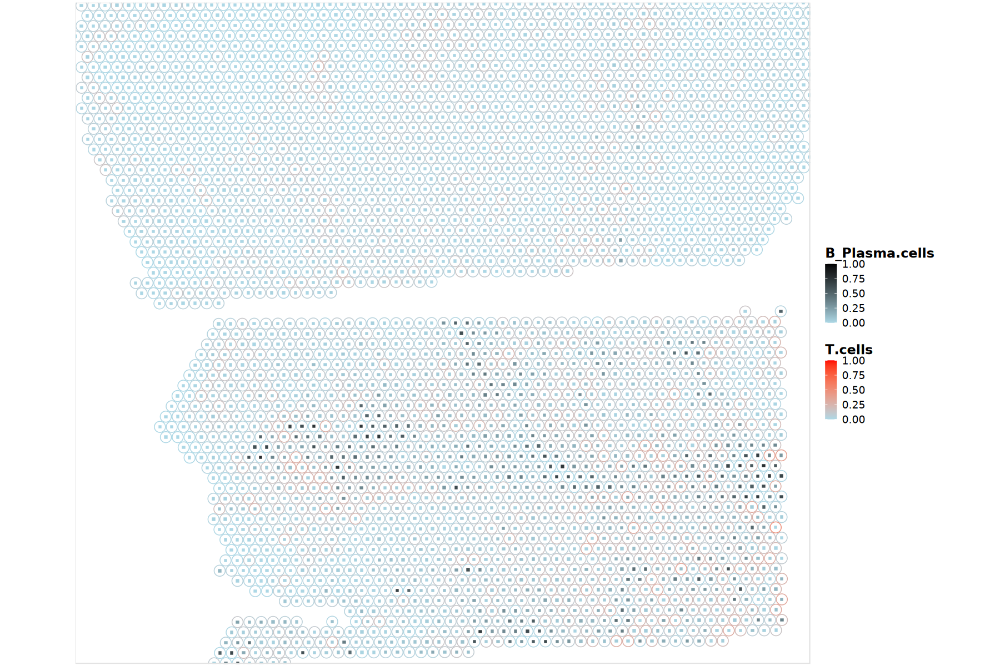

In [138]:
  for (slide in c("A", "B", "C", "D")) {
    card_file <- paste0("CARD_", slide, "_celltype_newref_prop.csv")
    card_data <- read.delim(card_file, sep = ",", header = TRUE, row.names = 1)
    
    # Visualize
    p <- visualize.prop.2CT(
      proportion = t(card_data),
      spatial_location = rotate_slide_coords(seurat_list[[slide]]),
      ct2.visualize = c("T.cells", "B_Plasma.cells"),
      colors = list(c("lightblue", "red"), 
                c("lightblue","black"))
    )
    
    plot_list[[slide]] <- p
    print(p)
    # save plot to pdf
    ggsave(paste0("CARD_", slide, "_Tcells_BPlasmacells_colocalization.pdf"), plot = p, width = 15, height = 15)
  }
  

# plot T cell and PAEP

[1] "Global maximum PAEP : 2.63905732961526"
[1] "Global maximum T.cells : 0.825116240293267"


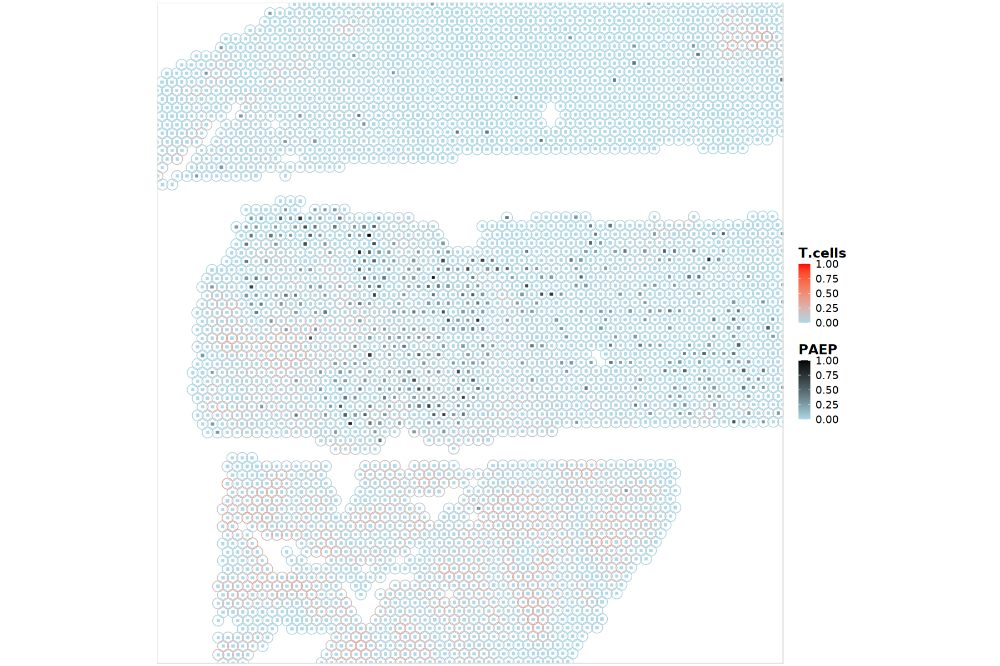

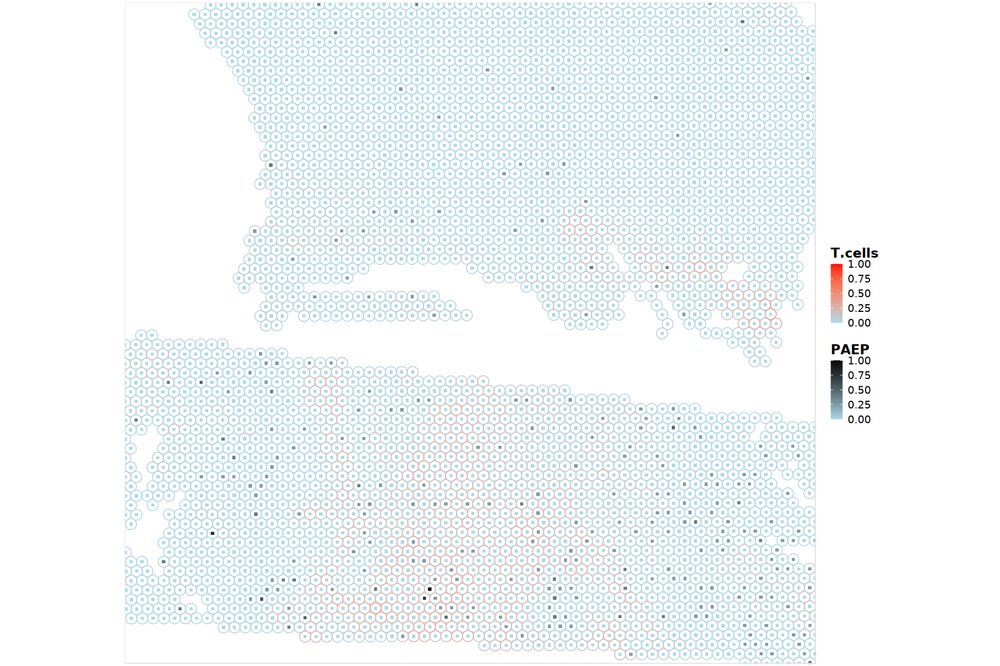

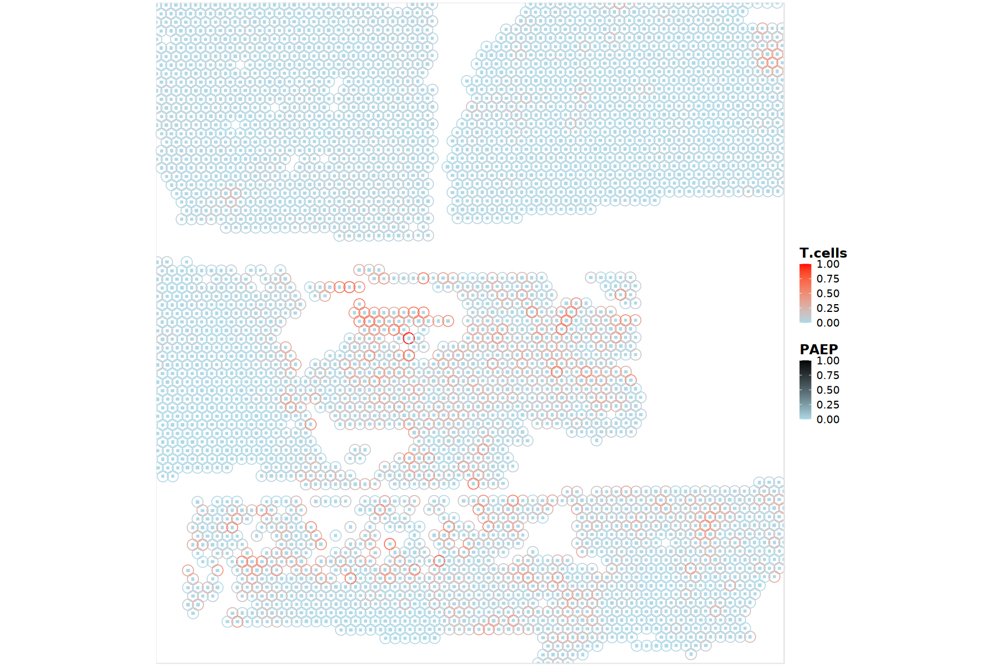

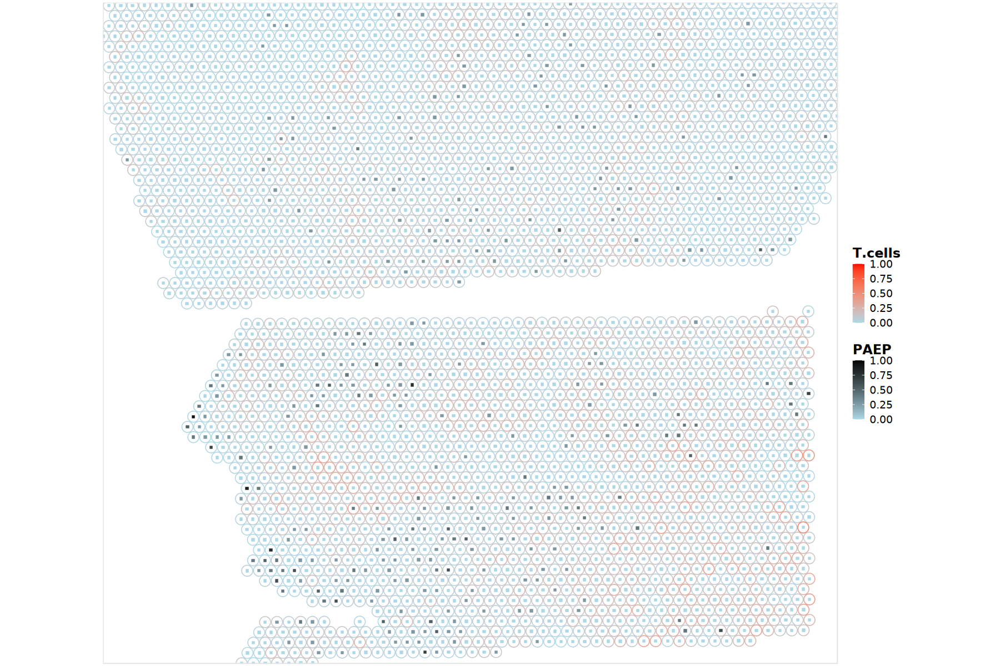

In [21]:
normalize_and_visualize_slides <- function(slides, seurat_list, cell_types, gene_name, 
                                         colors = NULL, slot = "data") {
  # Find global maximums
  max_vals <- list()
  max_vals[[gene_name]] <- 0
  for(ct in cell_types) {
    max_vals[[ct]] <- 0
  }
  
  # First pass: find maximums
  for (slide in slides) {
    card_file <- paste0("CARD_", slide, "_celltype_newref_prop.csv")
    card_data <- read.delim(card_file, sep = ",", header = TRUE, row.names = 1)
    card_data <- add_gene_to_card(seurat_list[[slide]], card_data, gene_name, slot = slot)
    
    max_vals[[gene_name]] <- max(max_vals[[gene_name]], max(card_data[gene_name,]))
    for(ct in cell_types) {
      max_vals[[ct]] <- max(max_vals[[ct]], max(card_data[ct,]))
    }
  }
  
  # Print maximums
  for(name in names(max_vals)) {
    print(paste("Global maximum", name, ":", max_vals[[name]]))
  }
  
  # Second pass: normalize and visualize
  plot_list <- list()
  
  for (slide in slides) {
    card_file <- paste0("CARD_", slide, "_celltype_newref_prop.csv")
    card_data <- read.delim(card_file, sep = ",", header = TRUE, row.names = 1)
    card_data <- add_gene_to_card(seurat_list[[slide]], card_data, gene_name, slot = slot)
    
    # Normalize all specified cell types and genes
    for(name in names(max_vals)) {
      card_data[name,] <- card_data[name,] / max_vals[[name]]
    }
    
    # Visualize
    p <- visualize.prop.2CT(
      proportion = t(card_data),
      spatial_location = rotate_slide_coords(seurat_list[[slide]]),
      ct2.visualize = c(cell_types[1], gene_name),
      colors = colors
    )
    
    plot_list[[slide]] <- p
    print(p)
  }
  
  return(plot_list)
}

# Usage
plot_list <- normalize_and_visualize_slides(
  slides = c("A", "B", "C", "D"),
  seurat_list = seurat_list,
  cell_types = "T.cells",
  gene_name = "PAEP",
  colors = list(c("lightblue", "red"), 
                c("lightblue","black"))

)
# save plots to pdf
for (slide in names(plot_list)) {
  ggsave(paste0("CARD_", slide, "_Tcells_PAEP_colocalization.pdf"), plot = plot_list[[slide]], width = 15, height = 15)
}

# plot B cell and PAEP

[1] "Global maximum PAEP : 2.63905732961526"
[1] "Global maximum B_Plasma.cells : 0.937167305653811"


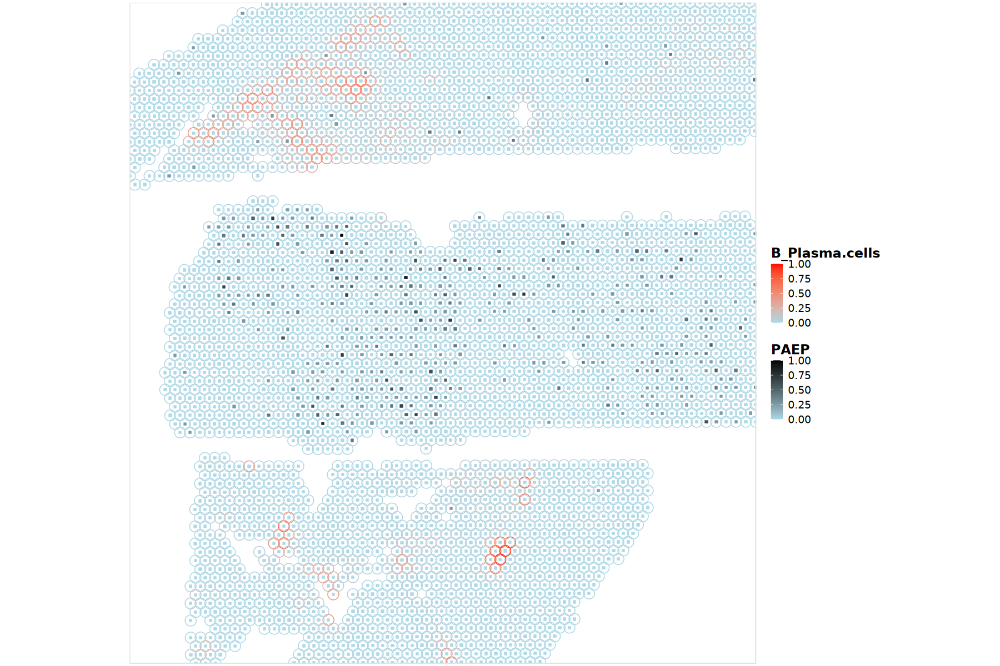

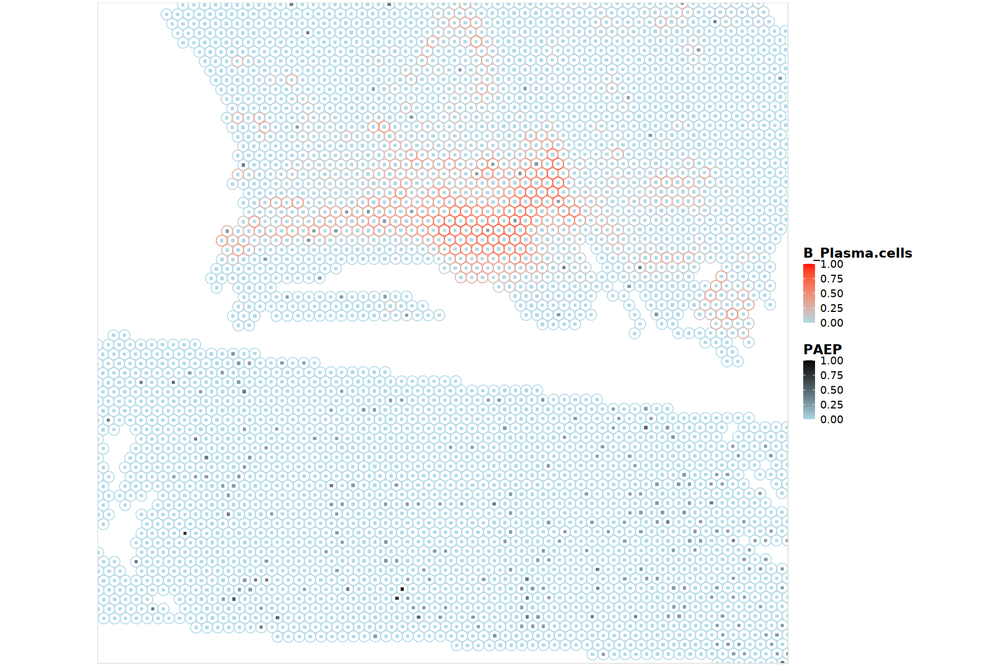

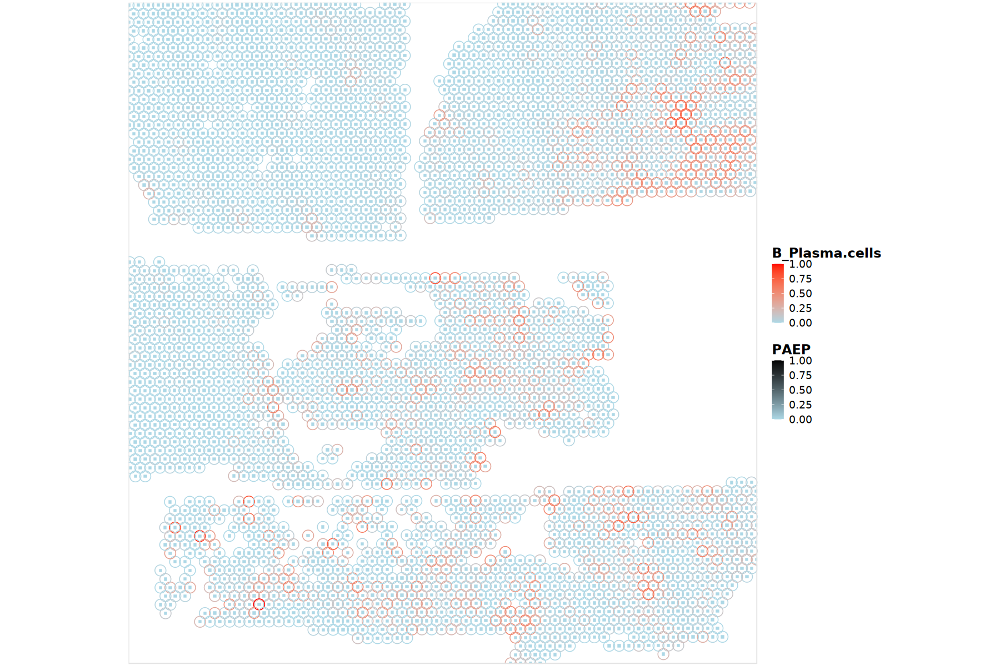

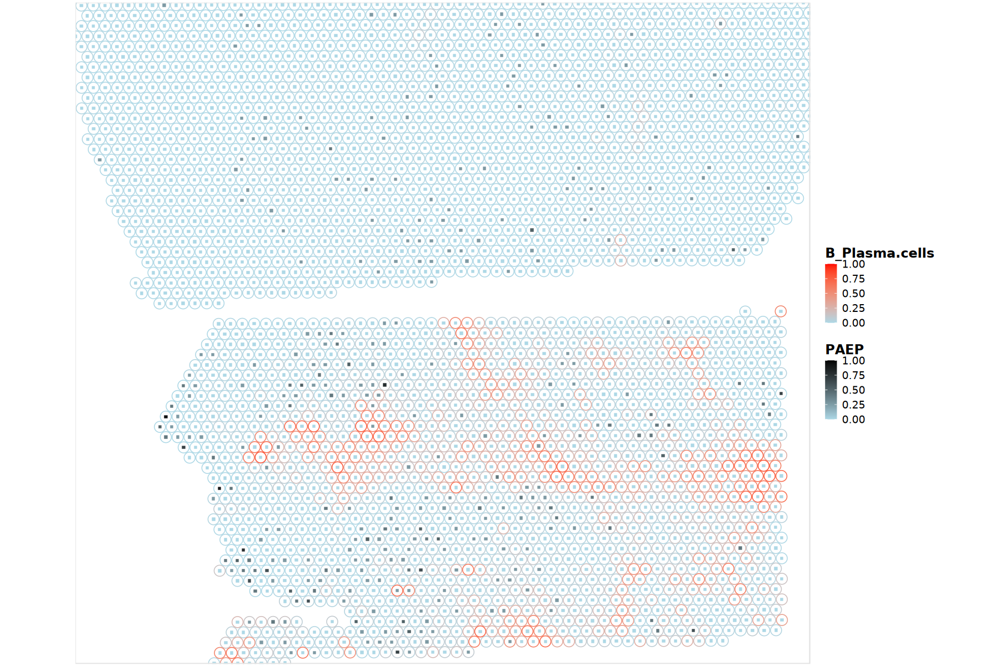

In [133]:
plot_list <- normalize_and_visualize_slides(
  slides = c("A", "B", "C", "D"),
  seurat_list = seurat_list,
  cell_types = "B_Plasma.cells",
  gene_name = "PAEP",
  colors = list(c("lightblue", "red"), 
                c("lightblue","black"))
)
# save plots to pdf
for (slide in names(plot_list)) {
  ggsave(paste0("CARD_", slide, "_BPlasmacells_PAEP_colocalization.pdf"), plot = plot_list[[slide]], width = 15, height = 15)
}

# plot B cell and IFNLR1

[1] "Global maximum CD22 : 1.09861228866811"
[1] "Global maximum B_Plasma.cells : 0.937167305653811"


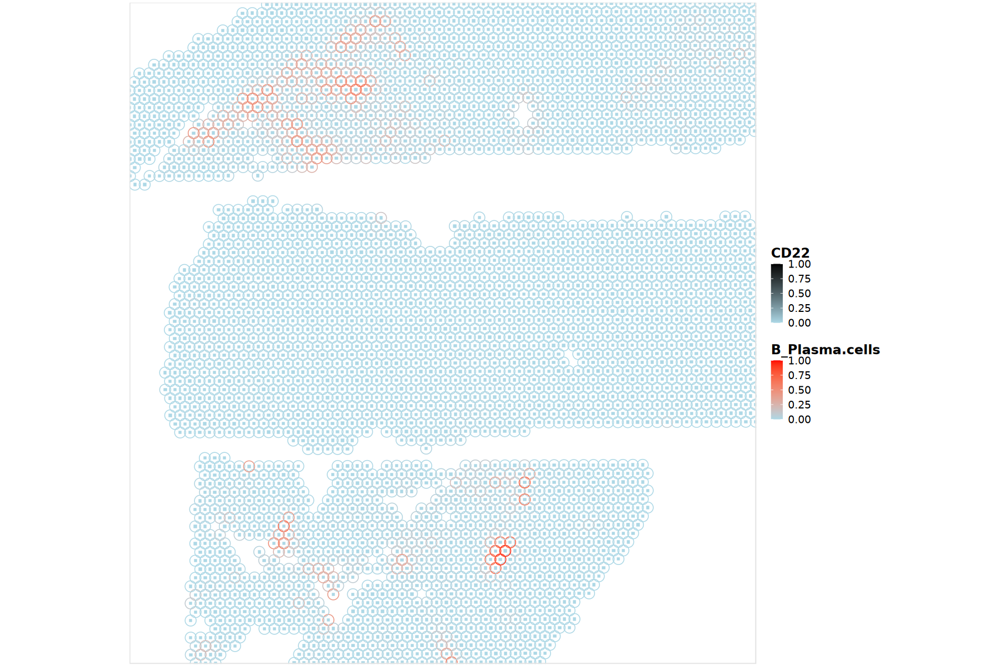

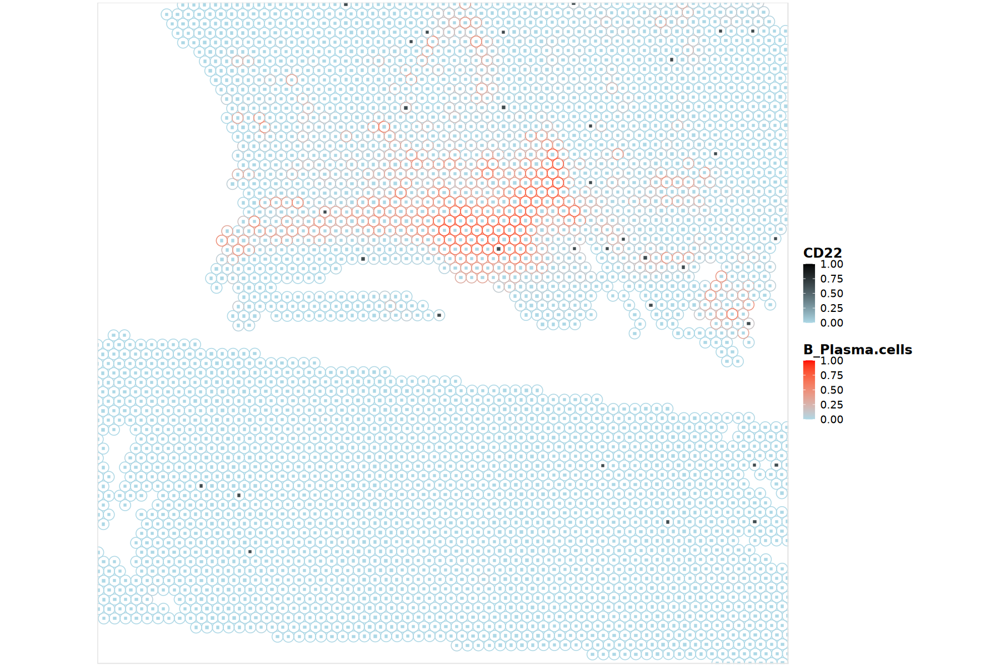

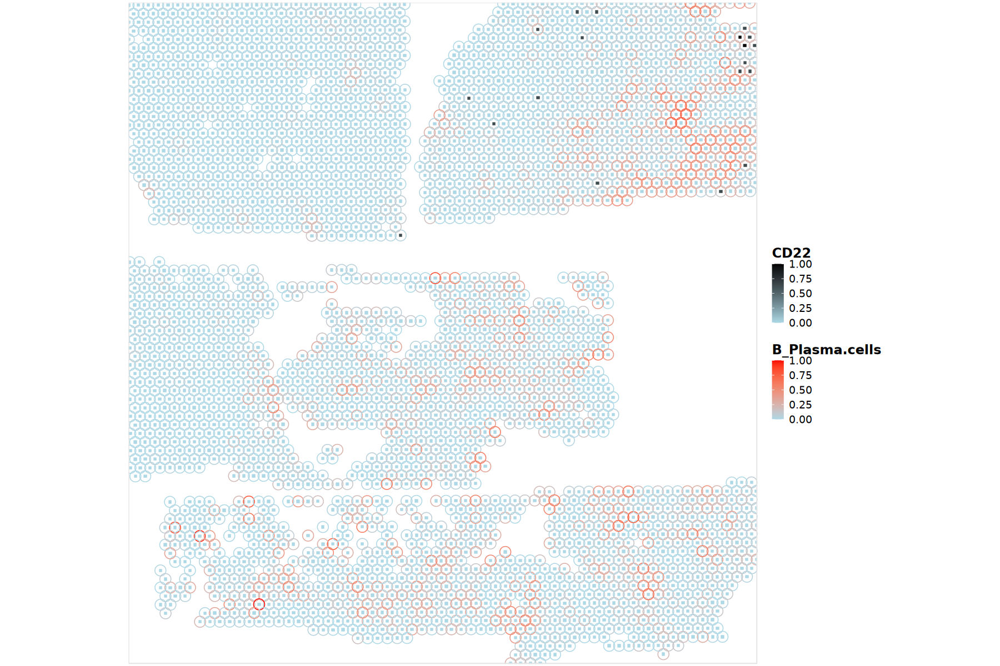

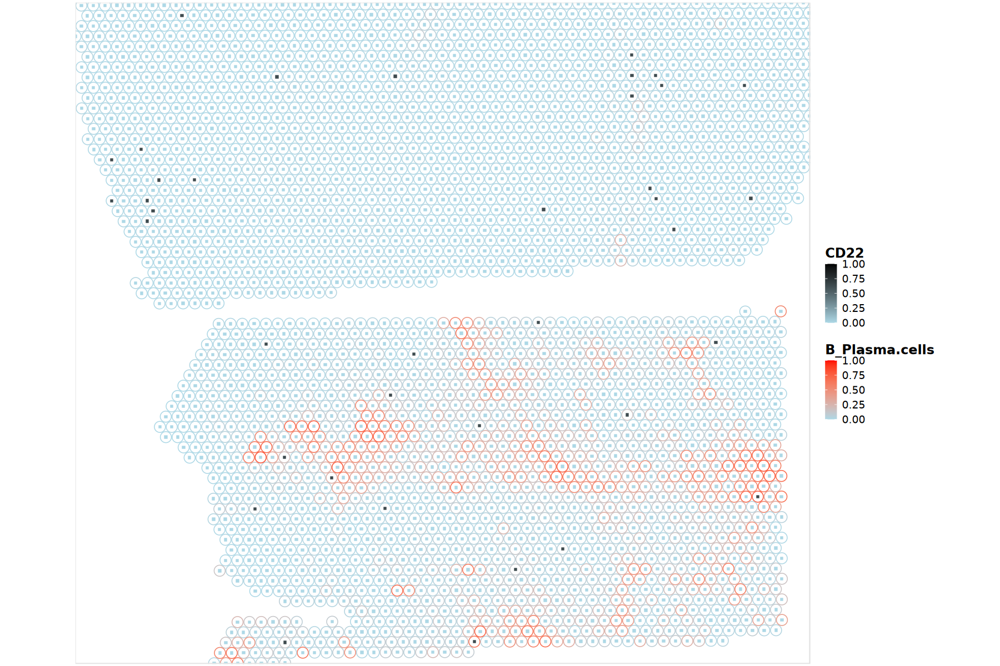

In [16]:
plot_list <- normalize_and_visualize_slides(
  slides = c("A", "B", "C", "D"),
  seurat_list = seurat_list,
  cell_types = "B_Plasma.cells",
  gene_name = "CD22",
  colors = list(c("lightblue", "red"), 
                c("lightblue","black"))
)

# plot PAEP and IFNLR1

In [17]:
visualize.gene.2exp <- function(expression_data, spatial_location, genes.visualize = genes.visualize, 
                               colors = NULL, slot = "data"){
  if(is.null(colors)){
    colors = list(c("lightblue","lightyellow","red"),
                  c("lightblue","lightyellow","black"))
  }else{
    colors = colors
  }
  
  res_exp = as.data.frame(expression_data)
  res_exp = res_exp[,order(colnames(res_exp))]
  location = as.data.frame(spatial_location)
  
  if(sum(rownames(res_exp)==rownames(location))!= nrow(res_exp)){
    stop("The rownames of expression data does not match with the rownames of spatial location data")
  }
  
  genes.select = genes.visualize
  res_exp = res_exp[,genes.select]
  
  # Use original values without scaling
  res_exp_scale = res_exp
  res_exp_scale$x = as.numeric(location$x)
  res_exp_scale$y = as.numeric(location$y)
  
  mData = melt(res_exp_scale, id.vars = c("x","y"))
  colnames(mData)[3] <- "Gene"
  
  p = suppressMessages(ggplot() + 
    geom_point(data=mData[mData$Gene == genes.visualize[1],], 
               aes(x=x, y=y, color=value), shape=21, size=5) +
    scale_color_gradientn(colours = colors[[1]], limits = c(0, 1)) +  # Force legend to 0-1
    geom_point(data=mData[mData$Gene == genes.visualize[2],], 
               aes(x=x, y=y, fill = value), color = "white", shape=22, size=2) +
    scale_fill_gradientn(colours = colors[[2]], limits = c(0, 1)) +   # Force legend to 0-1
    scale_x_discrete(expand = c(0, 1)) + 
    scale_y_discrete(expand = c(0,1)) + 
    coord_fixed() +
    theme(plot.margin = margin(0.1, 0.1, 0.1, 0.1, "cm"),
          panel.background = element_blank(),
          plot.background = element_blank(),
          panel.border = element_rect(colour = "grey89", fill=NA, size=0.5),
          axis.text = element_blank(),
          axis.ticks = element_blank(),
          axis.title = element_blank(),
          legend.title = element_text(size = 14, face="bold"),
          legend.text = element_text(size = 11),
          strip.text = element_text(size = 12, face="bold"),
          legend.key.size = unit(0.45, 'cm')) +
    labs(colour = genes.visualize[1], fill = genes.visualize[2]))
  
  return(p)
}

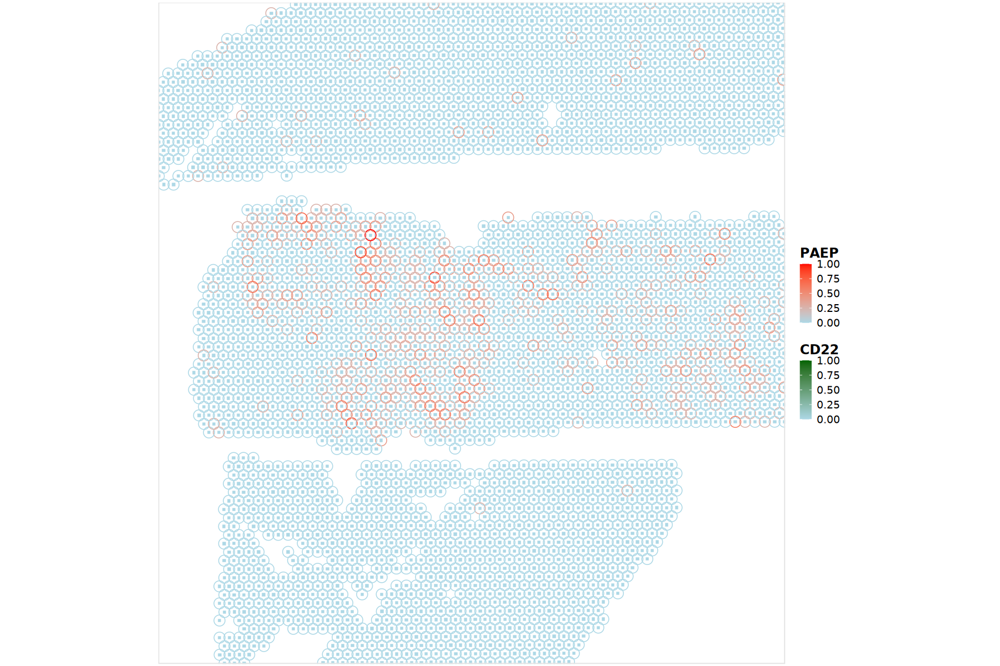

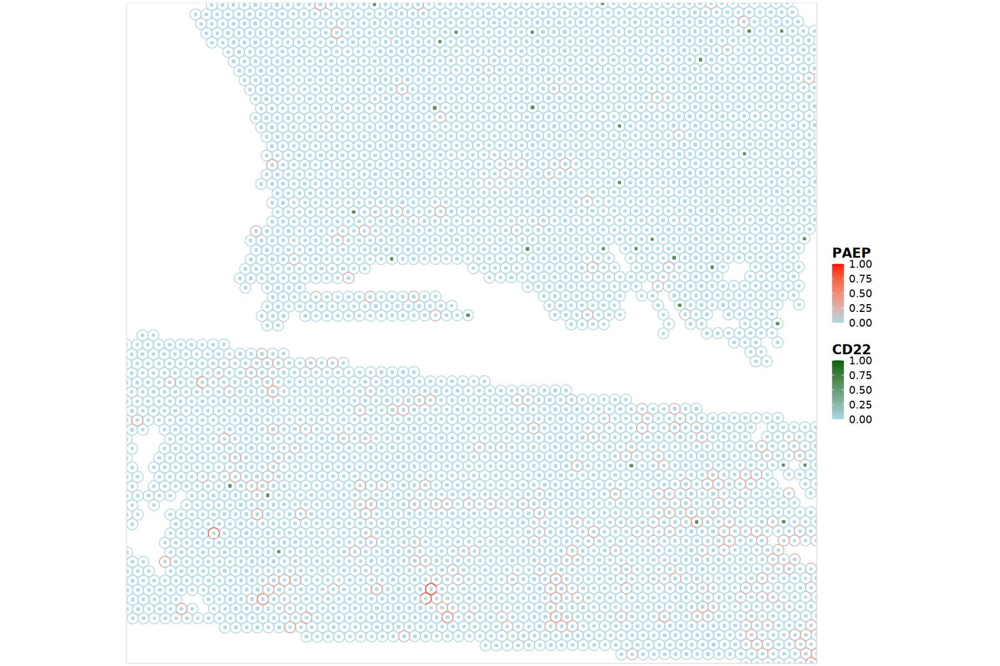

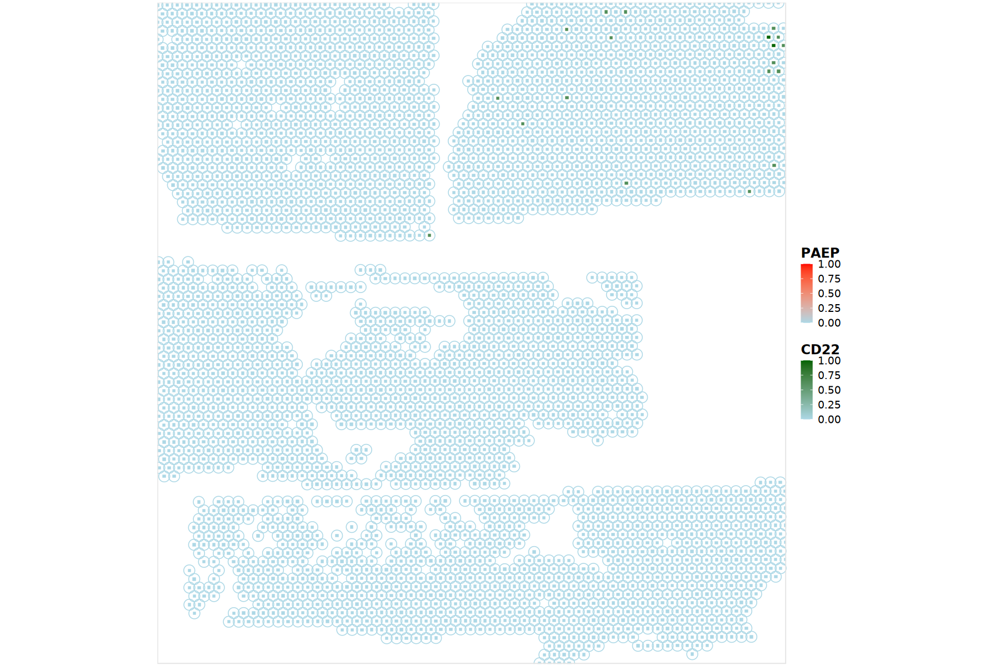

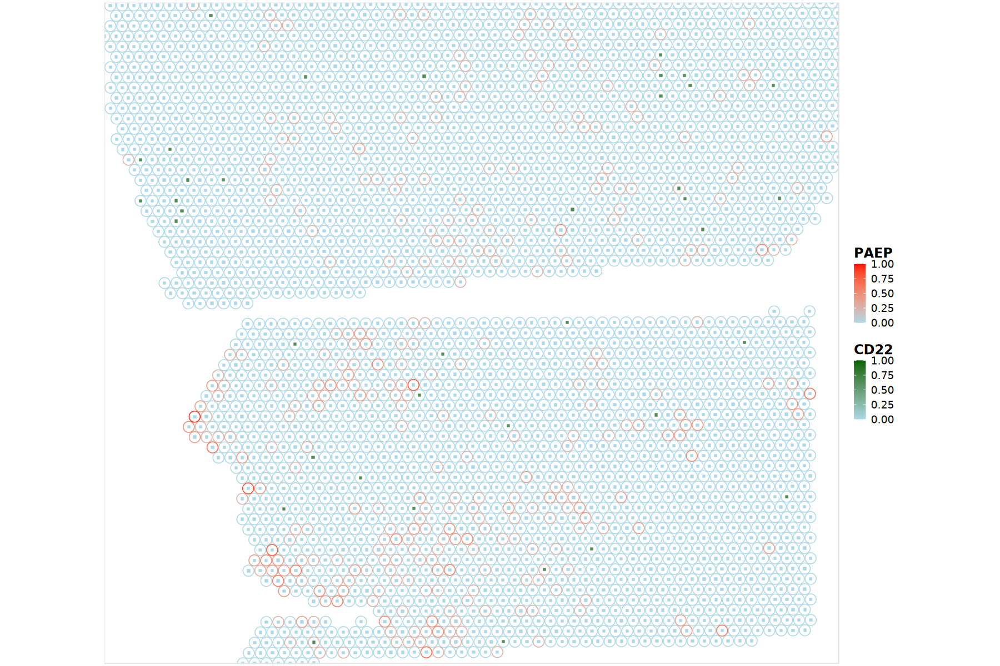

In [18]:
# Function to extract and visualize gene expression for multiple slides
visualize_genes_across_slides <- function(seurat_list, slides, genes, normalize_global = TRUE) {
  plot_list <- list()
  
  if(normalize_global) {
    # Find global max for each gene
    max_vals <- setNames(rep(0, length(genes)), genes)
    
    for(slide in slides) {
      for(gene in genes) {
        exp_vals <- GetAssayData(seurat_list[[slide]], slot = "data")[gene, ]
        max_vals[gene] <- max(max_vals[gene], max(exp_vals, na.rm = TRUE))
      }
    }
  }
  
  for(slide in slides) {
    # Extract gene expression
    gene_exp <- GetAssayData(seurat_list[[slide]], slot = "data")[genes, ]
    gene_exp_df <- as.data.frame(t(as.matrix(gene_exp)))
    
    # Normalize if requested
    if(normalize_global) {
      for(gene in genes) {
        gene_exp_df[,gene] <- gene_exp_df[,gene] / max_vals[gene]
      }
    }
    
    # Create visualization
    p <- visualize.gene.2exp(
      expression_data = gene_exp_df,
      spatial_location = rotate_slide_coords(seurat_list[[slide]]),
      genes.visualize = genes,
      colors = list(c("lightblue", "red"), 
                    c("lightblue","darkgreen"))
    )
    
    plot_list[[slide]] <- p
    print(p)
  }
  
  return(plot_list)
}

# Use the function
plots <- visualize_genes_across_slides(
  seurat_list = seurat_list,
  slides = c("A", "B", "C", "D"),
  genes = c("PAEP", "CD22"),
  normalize_global = TRUE
)
# save plots to pdf
for (slide in names(plots)) {
  ggsave(paste0("CARD_", slide, "_PAEP_IFNLR1_colocalization.pdf"), plot = plots[[slide]], width = 15, height = 15)
}

# test data structure

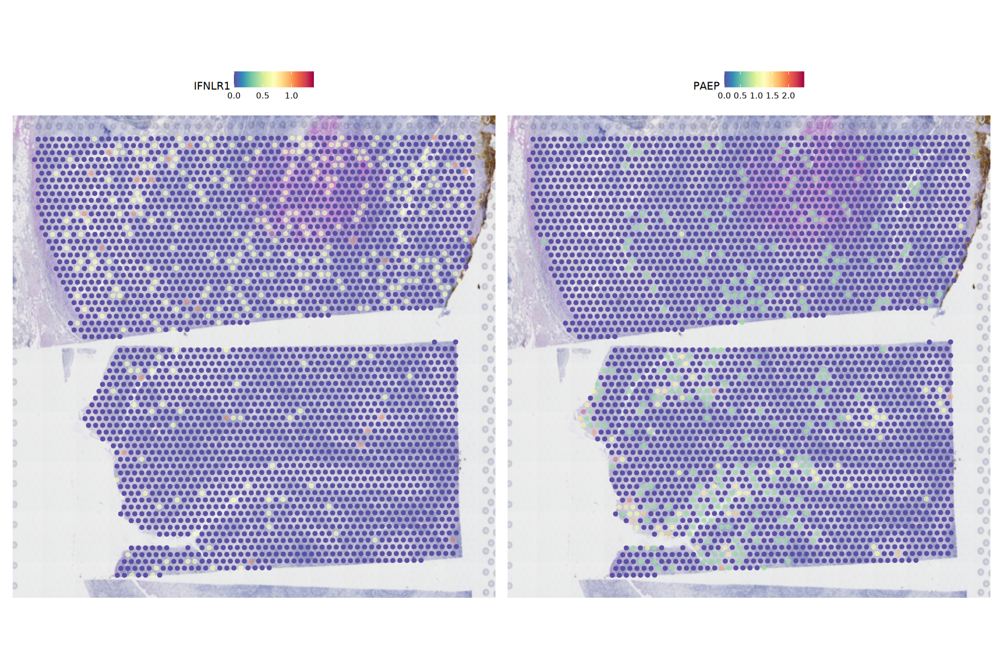

In [129]:
SpatialFeaturePlot(
  merged_VLP39_filtered,
  features = c("IFNLR1","PAEP"),     # Or "nFeature_RNA", depending on your object
  images = "slice1.4",
  alpha = c(1, 0.3),                # Optional: transparency range (dots, image)
  pt.size.factor = 1.5,               # Make the dots big
)

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


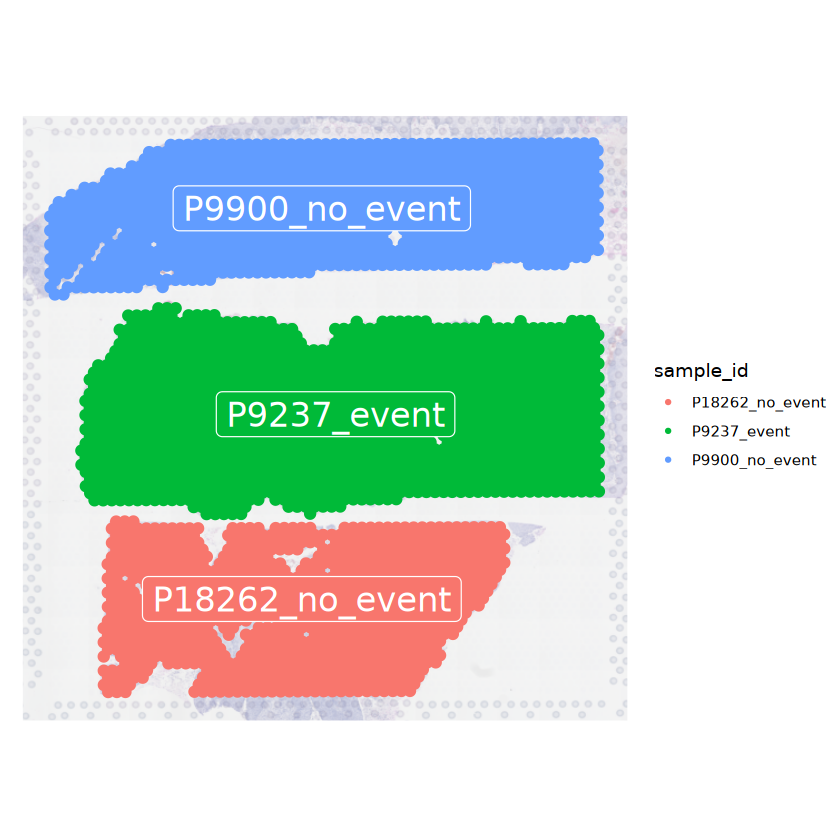

In [42]:
SpatialDimPlot(
  merged_VLP39_filtered,
  images = "slice1",
  group.by = "sample_id",  # <-- always use group.by for metadata columns
  label = TRUE,
  image.alpha = 0.6,       # Try less than 1 to make spots visible
  pt.size.factor = 3
)

In [9]:
test_data <- Load10X_Spatial(data.dir = "/QRISdata/Q4793/deconvolution/head_neck_cancer_VLP39_A2_outs",filename = "filtered_feature_bc_matrix.h5")

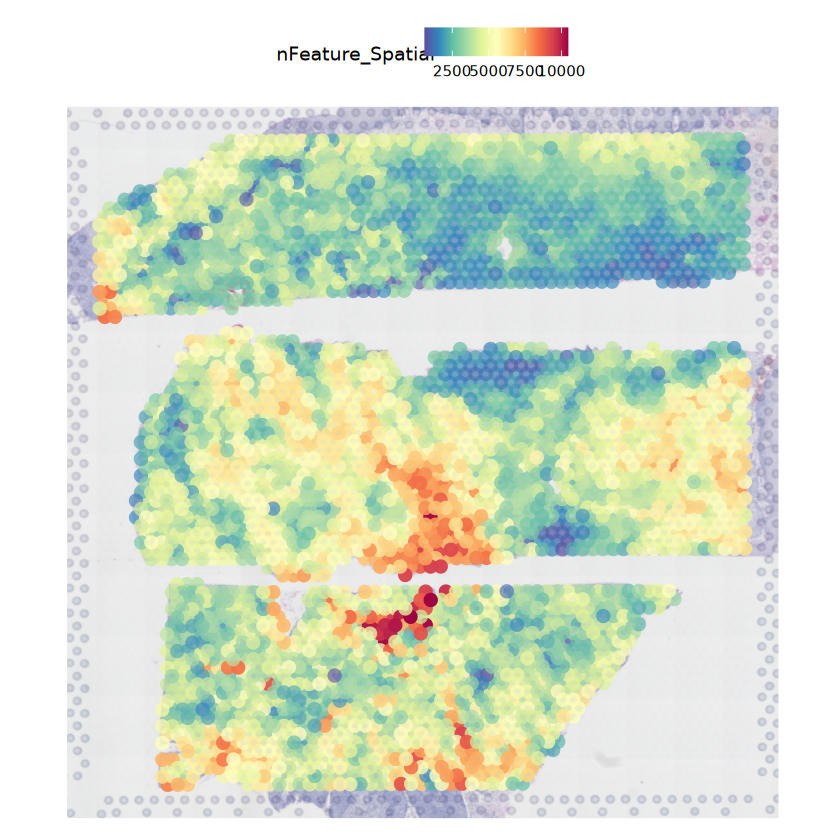

In [10]:
SpatialFeaturePlot(
  test_data,
  features = "nFeature_Spatial",     # Or "nFeature_RNA", depending on your object
  images = "slice1",
  alpha = c(0.6, 1),                # Optional: transparency range (dots, image)
  pt.size.factor = 3,               # Make the dots big
)

In [8]:
SpatialDimPlot(
  test_data,
  images = "slice1",
  group.by = "sample_id",  # <-- always use group.by for metadata columns
  label = TRUE,
  image.alpha = 0.6,       # Try less than 1 to make spots visible
  pt.size.factor = 3
)

ERROR: [1m[33mError[39m in `object[[group.by]]`:[22m
[33m![39m ‘sample_id’ not found in this Seurat object
 
